# Атмосферы за 2011 и 2012 годы

В эти годы установка включалась уже на высоте, поэтому профиля подъёма нет. Тем не менее, профили можно прикинуть по двум точкам: наземному давлению и давлению на высоте измерений. Данные бортового барометра берутся из базы Mongo, см. README

In [90]:
import pymongo
import dateutil.parser
from datetime import datetime
from tqdm import tqdm

client = pymongo.MongoClient()
db = client.sphere_telemetry

In [91]:
import numpy as np
import matplotlib.pyplot as plt

In [92]:
def ISODate(date_str: str) -> datetime:
    """"Comply with JavaScript ISODate func used in Mongo CLI"""
    return dateutil.parser.parse(date_str)

## 2012 год

In [94]:
aggregation = db.master.aggregate([
    {'$match': {'from_datum': {'$exists': True}}},
    {'$match': {'P0_hPa': {'$exists': True}}},
    {'$project': {'P0_hPa': True, 'utc_dt': True}},
    {'$match': {'utc_dt': {'$gt': ISODate("2012-01-01T00:00:00.000Z"), '$lt': ISODate("2013-01-01T00:00:00.000Z")}}},
])

dts_air = []
p_air = []
for doc in tqdm(aggregation):
    dts.append(doc['utc_dt'])
    p.append(doc['P0_hPa'])

1428it [00:00, 13941.28it/s]


In [95]:
dts_air = np.array(dts_air)
p_air = np.array(p_air)

In [96]:
mask_air = p_air > 0

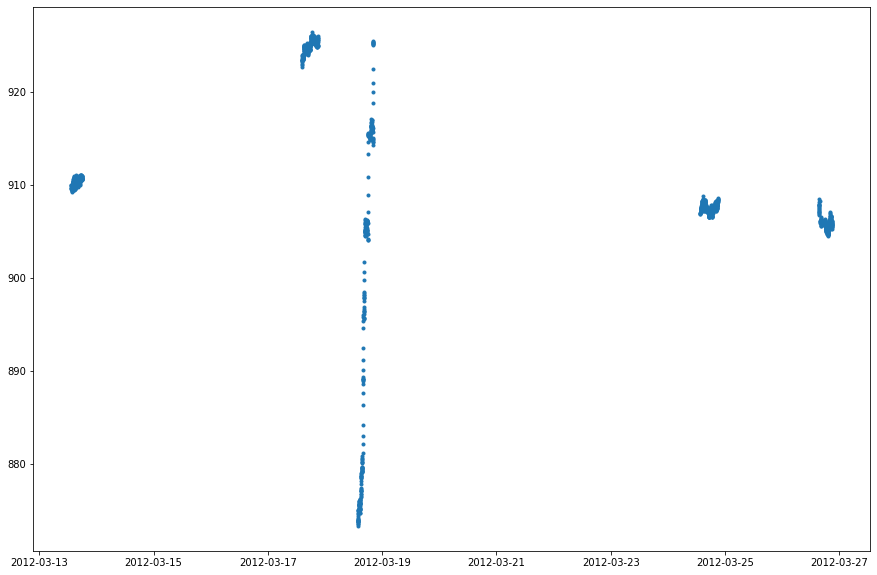

In [97]:
fig = plt.figure(1, (15, 10))
plt.plot(dts_air[mask_air], p_air[mask_air], '.')

plt.show()

# Наземные логи за 2012 год

In [98]:
aggregation = db.from_ground_logs.aggregate([
    {'$match': {'utc_dt': {'$exists': True}}},
    {'$match': {'P0_hPa': {'$exists': True}}},
    {'$project': {'P0_hPa': True, 'utc_dt': True}},
    {'$match': {'utc_dt': {'$gt': ISODate("2012-01-01T00:00:00.000Z"), '$lt': ISODate("2013-01-01T00:00:00.000Z")}}},
])

dts = []
p = []
for doc in tqdm(aggregation):
    dts.append(doc['utc_dt'])
    p.append(doc['P0_hPa'])

362514it [00:02, 129629.85it/s]


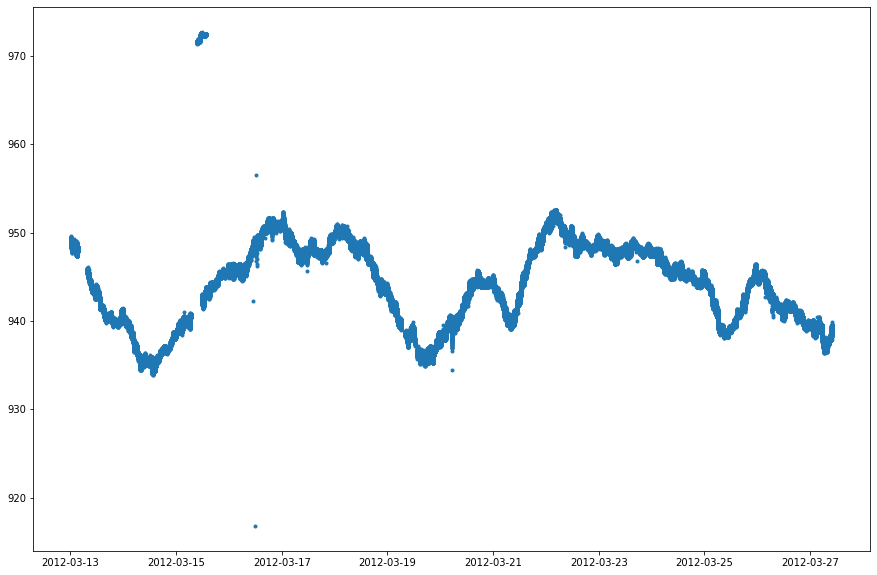

In [100]:
dts = np.array(dts)
p = np.array(p)
mask = p > 0

fig = plt.figure(1, (15, 10))
plt.plot(dts[mask], p[mask], '.')

plt.show()